## Scenario

You’re working for an investment firm. They ask you to identify which types of loans should be included in the portfolio that will maximize their return. Please clean the dataset, as if you were to do an analysis on it. The dataset is under the name Loan_Full at https://www.dropbox.com/sh/21uqtnt4r3im9go/AADVqLgruIzO5BErOkYSrdpTa?dl=0

The data is similar to Lending club data,  peer to peer lending company based in the United States, in which investors provide funds for potential borrowers and investors earn a profit depending on the risk they take (the borrowers credit score)


In this project I tried to analyze the data to build an informed portfolio for an investment firm. It allows the firm to choose which loans to invest in. 

In [0]:
# mount google drive
from google.colab import drive
drive.mount("/content/drive")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [0]:
# #required for Google Colab
!pip install --upgrade statsmodels 
!pip install --upgrade pandas
!pip install --upgrade seaborn
!sudo apt-get install libsnappy-dev
!pip install snappy
!pip install python-snappy
!pip install fastparquet

Requirement already up-to-date: statsmodels in /usr/local/lib/python3.6/dist-packages (0.9.0)
Requirement already up-to-date: pandas in /usr/local/lib/python3.6/dist-packages (0.24.2)
Requirement already up-to-date: seaborn in /usr/local/lib/python3.6/dist-packages (0.9.0)
Reading package lists... Done
Building dependency tree       
Reading state information... Done
libsnappy-dev is already the newest version (1.1.7-1).
The following package was automatically installed and is no longer required:
  libnvidia-common-410
Use 'sudo apt autoremove' to remove it.
0 upgraded, 0 newly installed, 0 to remove and 11 not upgraded.


In [0]:
# import required packages and libraries
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from tabulate import tabulate
import calendar
import time
import warnings

import plotly.offline as pyo
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly import tools

# Set notebook mode to work in offline
pyo.init_notebook_mode()

# converting int to month abbr
import calendar

# removes warnings when plotting time-series with seaborn
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()

from sklearn.preprocessing import StandardScaler, LabelEncoder, MinMaxScaler
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score


# # conda install -c conda-forge graphviz
# # conda install -c conda-forge python-graphviz
# conda install -c conda-forge python-snappy 
#conda install -c conda-forge snappy 


# enable plotly for google_colab
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))

### 1. Load Data 

In [0]:
# set google drive directory
directory_in_str = "/content/drive/My Drive/loan_data/"

In [0]:
# load the data
loan_full = pd.read_csv(directory_in_str + "Loan_Full.csv",  skipinitialspace=True,
    header=1, low_memory=False)
loan_full.drop(loan_full.tail(4).index,inplace=True)

In [0]:
# view data
loan_full.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,orig_projected_additional_accrued_interest,hardship_payoff_balance_amount,hardship_last_payment_amount,debt_settlement_flag,debt_settlement_flag_date,settlement_status,settlement_date,settlement_amount,settlement_percentage,settlement_term
0,NaN,NaN,5000.0,5000.0,4975.0,36 months,10.65%,162.87,B,B2,...,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,2500.0,2500.0,2500.0,60 months,15.27%,59.83,C,C4,...,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,2400.0,2400.0,2400.0,36 months,15.96%,84.33,C,C5,...,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,10000.0,10000.0,10000.0,36 months,13.49%,339.31,C,C1,...,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,3000.0,3000.0,3000.0,60 months,12.69%,67.79,B,B5,...,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN


In [0]:
# get info
loan_full.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 42538 entries, 0 to 42537
Columns: 144 entries, id to settlement_term
dtypes: float64(115), object(29)
memory usage: 47.1+ MB


In [0]:
# read data dictionary provided by lending club(in excel format)
LCdata_dictionary = pd.read_excel(directory_in_str + "LCDataDictionary.xlsx")
LCdata_dictionary.head()

,LoanStatNew,Description
0,acc_now_delinq,The number of accounts on which the borrower i...
1,acc_open_past_24mths,Number of trades opened in past 24 months.
2,addr_state,The state provided by the borrower in the loan...
3,all_util,Balance to credit limit on all trades
4,annual_inc,The self-reported annual income provided by th...


In [0]:
# change it to python dictionary
LCdata_dictionary = dict(zip(LCdata_dictionary.LoanStatNew.str.strip(), LCdata_dictionary.Description))

In [0]:
# pretty print description of the columns in the dataset
description_df = {"No.": [i for i in range(1, len(loan_full.columns)+1)], 
                  "Features":loan_full.columns, 
                  "Description":[LCdata_dictionary[c.strip()] for c in loan_full.columns]}

print(tabulate(description_df, headers='keys', tablefmt='psql'))

+-------+--------------------------------------------+-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
|   No. | Features                                   | Description                                                                                                                                                                                                                               |
|-------+--------------------------------------------+-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------|
|     1 | id                                         | A unique LC assigned ID for the loan listing.                           

In [0]:
# get number missing values in each column
def get_missing_values(data):
    total = data.isnull().sum()
    relative = 100 * data.isnull().sum() / len(data)
    table = pd.concat([total, relative], axis=1)
    table = table.rename(columns = {0 : '# Missing', 1 : '% Missing', 2: 'Data-Type'})
    table = table[ table.iloc[:,1] != 0].sort_values('# Missing', ascending=False).round(1)   
    return table

In [0]:
table = get_missing_values(loan_full)
table.sample(10)

,# Missing,% Missing
last_pymnt_d,86,0.2
pub_rec,32,0.1
int_rate,3,0.0
total_bc_limit,42538,100.0
tot_coll_amt,42538,100.0
sec_app_num_rev_accts,42538,100.0
sec_app_collections_12_mths_ex_med,42538,100.0
num_bc_tl,42538,100.0
mo_sin_rcnt_rev_tl_op,42538,100.0
num_sats,42538,100.0


In [0]:
# find features with 50% or more missing values
features_to_remove = table[table["% Missing"] > 50].index.tolist()
print(len(features_to_remove), " out of ", len(loan_full.columns))
print(features_to_remove)

91  out of  144
['total_cu_tl', 'num_op_rev_tl', 'open_acc_6m', 'tot_cur_bal', 'tot_coll_amt', 'mort_acc', 'verification_status_joint', 'dti_joint', 'annual_inc_joint', 'mths_since_recent_bc', 'mths_since_recent_bc_dlq', 'mths_since_last_major_derog', 'mths_since_recent_inq', 'mths_since_recent_revol_delinq', 'num_accts_ever_120_pd', 'num_actv_bc_tl', 'num_actv_rev_tl', 'num_bc_sats', 'num_bc_tl', 'open_act_il', 'open_il_12m', 'open_il_24m', 'member_id', 'mo_sin_rcnt_rev_tl_op', 'mo_sin_rcnt_tl', 'bc_util', 'bc_open_to_buy', 'avg_cur_bal', 'acc_open_past_24mths', 'inq_last_12m', 'inq_fi', 'mths_since_rcnt_il', 'total_rev_hi_lim', 'all_util', 'max_bal_bc', 'open_rv_24m', 'open_rv_12m', 'il_util', 'total_bal_il', 'num_il_tl', 'num_rev_accts', 'mo_sin_old_rev_tl_op', 'num_rev_tl_bal_gt_0', 'url', 'sec_app_collections_12_mths_ex_med', 'sec_app_mths_since_last_major_derog', 'hardship_type', 'hardship_reason', 'hardship_status', 'deferral_term', 'hardship_amount', 'hardship_start_date', 'har

In [0]:
# drop features
loan_full.drop(labels=features_to_remove, axis=1, inplace=True)

In [0]:
# remove features that are not available before the loan

features_to_remove = ['acc_now_delinq', 
                     'chargeoff_within_12_mths',
                      'collection_recovery_fee',
                      'collections_12_mths_ex_med',
                      'debt_settlement_flag',
                      'delinq_2yrs',
                      'delinq_amnt',
                     'funded_amnt', 
                      'funded_amnt_inv',
                      'hardship_flag',
                      'inq_last_6mths',
                      'last_credit_pull_d',
                      'last_pymnt_amnt',
                      'last_pymnt_d',
                      'out_prncp', 
                      'out_prncp_inv', 
                      'pymnt_plan',
                      'recoveries',
                      'tax_liens',
                      'total_pymnt', 
                       'total_pymnt_inv', 
                      'total_rec_int', 
                      'total_rec_late_fee', 
                      'total_rec_prncp'
                     ]

loan_full.drop(labels=features_to_remove, axis=1, inplace=True)

### 2. Data Cleaning

In [0]:
def pretty_print_data():
  description_df = {"No.": [i for i in range(1, len(loan_full.columns)+1)], 
                    "Features":loan_full.columns, 
                    "Dtypes":loan_full.dtypes,
                    "Unique": [loan_full[c].nunique() 
                               if str(loan_full[c].dtype) == 'object' 
                               else -1 for c in loan_full],
                    "Nulls": loan_full.isnull().sum()
                   }
  print(tabulate(description_df, headers='keys', tablefmt='psql'))
  return description_df

In [0]:
description_df = pretty_print_data()

+-------+----------------------+----------+----------+---------+
|   No. | Features             | Dtypes   |   Unique |   Nulls |
|-------+----------------------+----------+----------+---------|
|     1 | loan_amnt            | float64  |       -1 |       3 |
|     2 | term                 | object   |        2 |       3 |
|     3 | int_rate             | object   |      394 |       3 |
|     4 | installment          | float64  |       -1 |       3 |
|     5 | grade                | object   |        7 |       3 |
|     6 | sub_grade            | object   |       35 |       3 |
|     7 | emp_title            | object   |    30655 |    2629 |
|     8 | emp_length           | object   |       11 |    1115 |
|     9 | home_ownership       | object   |        5 |       3 |
|    10 | annual_inc           | float64  |       -1 |       7 |
|    11 | verification_status  | object   |        3 |       3 |
|    12 | issue_d              | object   |       55 |       3 |
|    13 | loan_status    

In [0]:
# more than 30 unique values
pd.DataFrame(description_df).query("Unique > 30")

,No.,Features,Dtypes,Unique,Nulls
int_rate,3,int_rate,object,394,3
sub_grade,6,sub_grade,object,35,3
emp_title,7,emp_title,object,30655,2629
issue_d,12,issue_d,object,55,3
desc,14,desc,object,28952,13522
title,16,title,object,21226,16
zip_code,17,zip_code,object,837,3
addr_state,18,addr_state,object,50,3
earliest_cr_line,20,earliest_cr_line,object,530,32
revol_util,24,revol_util,object,1119,93


In [0]:
#### Interest Rate
def fix_interest_rate(x):
  if isinstance(x, str):
    return float(x.strip('%'))/100.
  else:
    return None

loan_full.loc[:, "int_rate"] = loan_full.int_rate.apply(fix_interest_rate)

In [0]:
#### revol_util 

def fix_revol_util(x):
  if isinstance(x, str):
    return float(x.strip('%'))/100.
  else:
    return None

loan_full.loc[:, "revol_util"] = loan_full.revol_util.apply(fix_revol_util)

In [0]:
#### pub_rec_bankruptcies
# 0: no record
# 1: 1 record
# 2: 2 records
# 3: Unknown
loan_full.pub_rec_bankruptcies.value_counts()
loan_full.loc[:, "pub_rec_bankruptcies"] = loan_full.pub_rec_bankruptcies.fillna(3.0)

In [0]:
### emp_length
# Nulls = "Unknown"
loan_full.loc[:, "emp_length"] = loan_full.emp_length.fillna("Unknown")

In [0]:
# drop unneccearry features(too many unique values)
# payment plan has the same value for all
loan_full.drop(["emp_title", 
                "desc", 
                "title",
                "zip_code",
                "sub_grade",
                "addr_state",
               ], axis=1, inplace=True)

In [0]:
# remove rows containg nulls
loan_full.dropna(inplace=True)
print(len(loan_full))

42445


### 3. Feature Extraction

In [0]:
import datetime
def convert_date(x):
  if isinstance(x, str):
    return datetime.datetime.strptime(x, '%b-%y').date()
  else:
    return None
#### date types
loan_full["issue_d_conv"] = pd.to_datetime(loan_full.issue_d.
                                           apply(convert_date)) 
loan_full["earliest_cr_conv"] = pd.to_datetime(loan_full.earliest_cr_line.
                                               apply(convert_date)) 
# loan_full["last_payment_day_conv"] = pd.to_datetime(loan_full.last_pymnt_d.
#                                                     apply(convert_date))
# loan_full["last_credit_pull_d_conv"] = pd.to_datetime(loan_full.last_credit_pull_d.
#                                                        apply(convert_date))

In [0]:
loan_full.issue_d_conv.dt.year.value_counts()

2011    21712
2010    12516
2009     5265
2008     2381
2007      571
Name: issue_d_conv, dtype: int64

In [0]:
loan_full.earliest_cr_conv.dt.year.value_counts().head()

2000    3435
1999    3151
1998    3064
2001    2663
1997    2618
Name: earliest_cr_conv, dtype: int64

In [0]:
# create one features
# how was the credit age of the customer when loan was issued
loan_full["credit_age"] = loan_full.issue_d_conv - loan_full["earliest_cr_conv"]
#loan_full["last_payment_minus_issue_date"] = loan_full.last_payment_day_conv - loan_full.issue_d_conv
# drop date features
loan_full.drop(["issue_d", 
                "earliest_cr_line", 
               "issue_d_conv",
               "earliest_cr_conv",
               ], axis=1, inplace=True)

In [0]:
_ = pretty_print_data()

+-------+----------------------+-----------------+----------+---------+
|   No. | Features             | Dtypes          |   Unique |   Nulls |
|-------+----------------------+-----------------+----------+---------|
|     1 | loan_amnt            | float64         |       -1 |       0 |
|     2 | term                 | object          |        2 |       0 |
|     3 | int_rate             | float64         |       -1 |       0 |
|     4 | installment          | float64         |       -1 |       0 |
|     5 | grade                | object          |        7 |       0 |
|     6 | emp_length           | object          |       12 |       0 |
|     7 | home_ownership       | object          |        5 |       0 |
|     8 | annual_inc           | float64         |       -1 |       0 |
|     9 | verification_status  | object          |        3 |       0 |
|    10 | loan_status          | object          |        4 |       0 |
|    11 | purpose              | object          |       14 |   

In [0]:
# convert time_delta to days
loan_full.loc[:, "credit_age"] = loan_full.credit_age.dt.days.astype('float64')
# loan_full.loc[:, "last_payment_minus_issue_date"] \
# = loan_full.last_payment_minus_issue_date.dt.days.astype('float64')

In [0]:
# get target varaible
print("\nbefore")
print(loan_full.loan_status.value_counts(normalize=True))
status = ['Fully Paid','Charged Off']
loan_full = loan_full.query("loan_status == @status")
print("\nafter")
print(loan_full.loan_status.value_counts(normalize=True))


before
Fully Paid                                             0.802969
Charged Off                                            0.133208
Does not meet the credit policy. Status:Fully Paid     0.046036
Does not meet the credit policy. Status:Charged Off    0.017788
Name: loan_status, dtype: float64

after
Fully Paid     0.857711
Charged Off    0.142289
Name: loan_status, dtype: float64


In [0]:
# one hot encode categorical features except loan status
nominal = loan_full.select_dtypes(include=['object']).drop("loan_status", axis=1)

In [0]:
# all this have single unique value
nominal[["initial_list_status",           
            "application_type"]].describe()

,initial_list_status,application_type
count,39736,39736
unique,1,1
top,f,Individual
freq,39736,39736


In [0]:
nominal.drop(["initial_list_status",           
            "application_type"], axis=1, inplace=True)

In [0]:
# create dummies
nominal_dummies_df = pd.get_dummies(nominal)

In [0]:
nominal_dummies_df.columns

Index(['term_36 months', 'term_60 months', 'grade_A', 'grade_B', 'grade_C',
       'grade_D', 'grade_E', 'grade_F', 'grade_G', 'emp_length_1 year',
       'emp_length_10+ years', 'emp_length_2 years', 'emp_length_3 years',
       'emp_length_4 years', 'emp_length_5 years', 'emp_length_6 years',
       'emp_length_7 years', 'emp_length_8 years', 'emp_length_9 years',
       'emp_length_< 1 year', 'emp_length_Unknown', 'home_ownership_MORTGAGE',
       'home_ownership_NONE', 'home_ownership_OTHER', 'home_ownership_OWN',
       'home_ownership_RENT', 'verification_status_Not Verified',
       'verification_status_Source Verified', 'verification_status_Verified',
       'purpose_car', 'purpose_credit_card', 'purpose_debt_consolidation',
       'purpose_educational', 'purpose_home_improvement', 'purpose_house',
       'purpose_major_purchase', 'purpose_medical', 'purpose_moving',
       'purpose_other', 'purpose_renewable_energy', 'purpose_small_business',
       'purpose_vacation', 'purpos

In [0]:
# drop features that were not available before the loan was issued

drop_list = ['acc_now_delinq', 'acc_open_past_24mths', 'avg_cur_bal', 'bc_open_to_buy', 'bc_util', 'chargeoff_within_12_mths', 'collection_recovery_fee', 'collections_12_mths_ex_med', 'debt_settlement_flag', 'delinq_2yrs', 'delinq_amnt', 'disbursement_method', 'funded_amnt', 'funded_amnt_inv', 'hardship_flag', 'inq_last_6mths', 'last_credit_pull_d', 'last_fico_range_high', 'last_fico_range_low', 'last_pymnt_amnt', 'last_pymnt_d', 'mo_sin_rcnt_rev_tl_op', 'mo_sin_rcnt_tl', 'mths_since_recent_bc', 'mths_since_recent_inq', 'num_accts_ever_120_pd', 'num_actv_bc_tl', 'num_actv_rev_tl', 'num_bc_sats', 'num_bc_tl', 'num_il_tl', 'num_op_rev_tl', 'num_rev_accts', 'num_rev_tl_bal_gt_0', 'num_sats', 'num_tl_120dpd_2m', 'num_tl_30dpd', 'num_tl_90g_dpd_24m', 'num_tl_op_past_12m',  'out_prncp', 'out_prncp_inv', 'pct_tl_nvr_dlq', 'percent_bc_gt_75', 'pymnt_plan', 'recoveries', 'tax_liens', 'tot_coll_amt', 'tot_cur_bal', 'tot_hi_cred_lim', 'total_bal_ex_mort', 'total_bc_limit', 'total_il_high_credit_limit', 'total_pymnt', 'total_pymnt_inv', 'total_rec_int', 'total_rec_late_fee', 'total_rec_prncp', 'total_rev_hi_lim']


### 4. Outliers

In [0]:
# numeric features
continous_df = loan_full.select_dtypes(include=['float64'])

In [0]:
# policy code has one single value
continous_df.policy_code.describe()   

count    39736.0
mean         1.0
std          0.0
min          1.0
25%          1.0
50%          1.0
75%          1.0
max          1.0
Name: policy_code, dtype: float64

In [0]:
continous_df.drop("policy_code", axis=1, inplace=True)

In [0]:
continous_df.describe()

,loan_amnt,int_rate,installment,annual_inc,dti,open_acc,pub_rec,revol_bal,revol_util,total_acc,pub_rec_bankruptcies,credit_age
count,39736.000000,39736.000000,39736.000000,3.973600e+04,39736.000000,39736.000000,39736.000000,39736.000000,39736.000000,39736.000000,39736.000000,39736.000000
mean,11239.581236,0.120233,324.942362,6.900962e+04,13.321366,9.299854,0.055164,13407.595983,0.488581,22.104867,0.095178,4958.041172
std,7464.479825,0.037265,208.931064,6.375830e+04,6.676682,4.398583,0.237700,15896.653298,0.283366,11.398302,0.437860,2710.876156
min,500.000000,0.054200,15.690000,4.000000e+03,0.000000,2.000000,0.000000,0.000000,0.000000,2.000000,0.000000,-21915.000000
25%,5500.000000,0.092500,167.132500,4.056000e+04,8.190000,6.000000,0.000000,3718.750000,0.254000,14.000000,0.000000,3318.000000
50%,10000.000000,0.118600,280.910000,5.900000e+04,13.410000,9.000000,0.000000,8868.000000,0.493000,20.000000,0.000000,4595.000000
75%,15000.000000,0.145900,431.285000,8.242500e+04,18.600000,12.000000,0.000000,17080.000000,0.724000,29.000000,0.000000,6209.000000
max,35000.000000,0.245900,1305.190000,6.000000e+06,29.990000,44.000000,4.000000,149588.000000,0.999000,90.000000,3.000000,15615.000000


In [0]:
len(continous_df.columns)

12

In [0]:
configure_plotly_browser_state()
fig = tools.make_subplots(rows=4, cols=4)

row = 1
col = 1
for i in range(0, len(continous_df.columns)):
  data = continous_df.iloc[:, i]
  trace = go.Box(y=continous_df.iloc[:, i], 
                 name=continous_df.columns[i] + 
                 "("+str(continous_df.iloc[:, i].nunique())+" uniques)")
  fig.append_trace(trace, row, col)
  if(col == 4):
    row += 1
    col = 1
  else:
    col +=1

fig['layout'].update(xaxis=dict(
    titlefont=dict(
        family='Arial, sans-serif',
        size=3),
    showticklabels=False))
fig['layout'].update(height=1024, width=800, title='', showlegend=False)
pyo.iplot(fig, filename='make-subplots-multiple-with-titles')

This is the format of your plot grid:
[ (1,1) x1,y1 ]    [ (1,2) x2,y2 ]    [ (1,3) x3,y3 ]    [ (1,4) x4,y4 ]  
[ (2,1) x5,y5 ]    [ (2,2) x6,y6 ]    [ (2,3) x7,y7 ]    [ (2,4) x8,y8 ]  
[ (3,1) x9,y9 ]    [ (3,2) x10,y10 ]  [ (3,3) x11,y11 ]  [ (3,4) x12,y12 ]
[ (4,1) x13,y13 ]  [ (4,2) x14,y14 ]  [ (4,3) x15,y15 ]  [ (4,4) x16,y16 ]



In [0]:
print(continous_df.shape)
print(nominal_dummies_df.shape)


(39736, 12)
(39736, 43)


In [0]:
target_df = loan_full.loan_status

In [0]:
# one line to remove outliers based on continous features
# ordinal features are not considered
boolean_indexer = (np.abs(stats.zscore(continous_df)) < 3).all(axis=1)

In [0]:
# remove outliers
continous_df = continous_df[boolean_indexer]
nominal_dummies_df = nominal_dummies_df[boolean_indexer]
target_df = loan_full.loan_status[boolean_indexer]

In [0]:
print(continous_df.shape)
print(nominal_dummies_df.shape)
print(target_df.shape)

(34271, 12)
(34271, 43)
(34271,)


In [0]:
# label encode target
le = LabelEncoder()
target_df = le.fit_transform(target_df)
print(le.classes_)

['Charged Off' 'Fully Paid']


In [0]:
target_df.shape

(34271,)

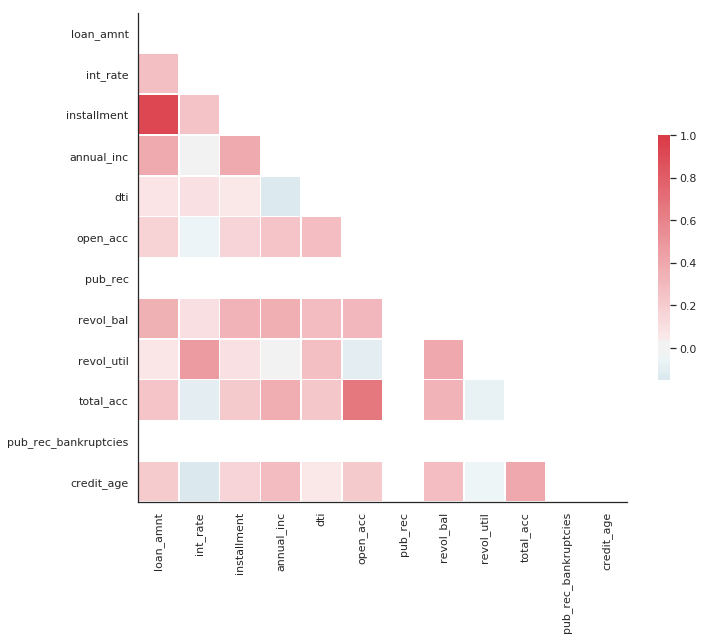

In [0]:
# correlation matrix
# Code from https://seaborn.pydata.org/examples/many_pairwise_correlations.html
sns.set(style="white")

# Compute the correlation matrix
corr = continous_df.corr()

# Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
sns.despine()

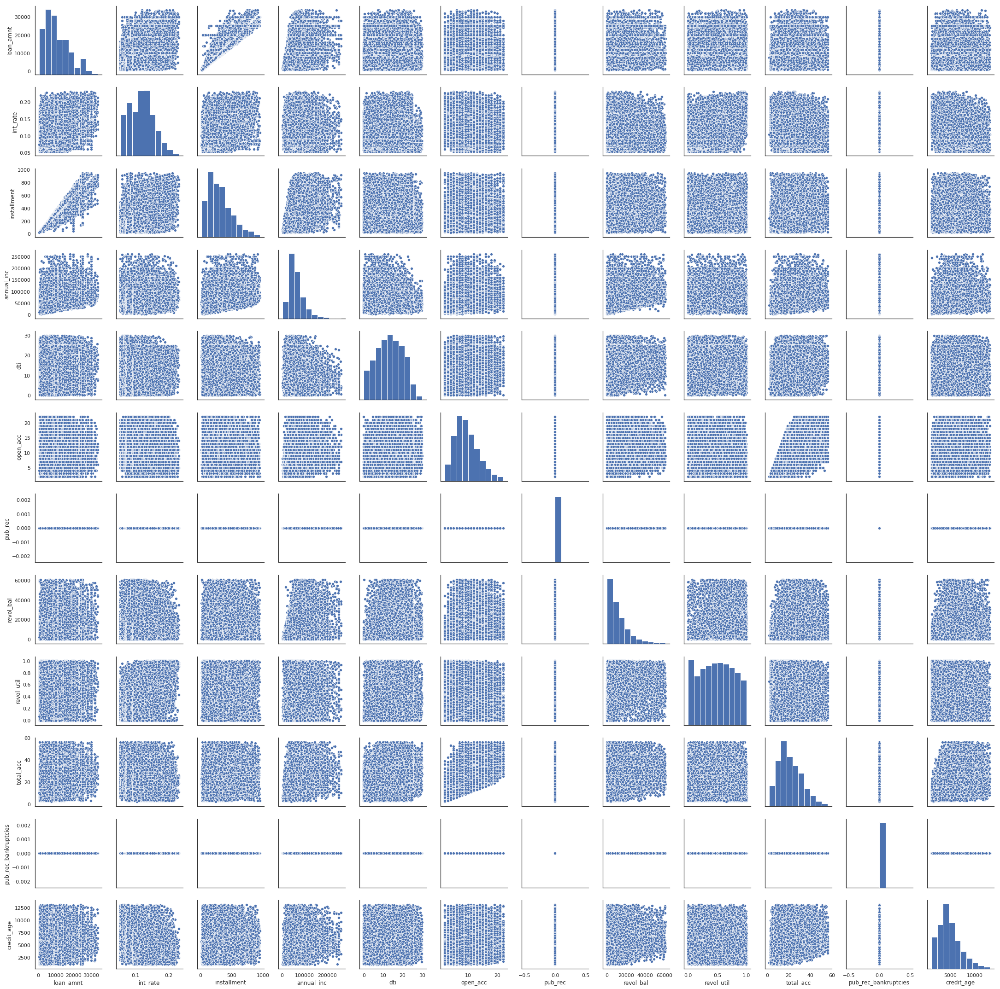

In [0]:
sns.pairplot(continous_df)
sns.despine()

### 5. Modeling

In [0]:
from sklearn.model_selection import train_test_split
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.preprocessing import Normalizer, StandardScaler
from imblearn.under_sampling import RandomUnderSampler


from sklearn.pipeline import make_pipeline
from sklearn.metrics import classification_report, confusion_matrix,roc_auc_score,average_precision_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC, LinearSVC
from sklearn.feature_selection import SelectFromModel
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
import lightgbm as lgb 
from sklearn.model_selection import ParameterGrid, GridSearchCV


In [0]:
# A function to be used for trying different models
def estimate(X_train, y_train, X_test, y_test, model_type, penalty_arg='l2', C_arg=1.0, solver="lbfgs",
            max_depth_arg=50, n_estimators_arg=900,  min_samples_leaf_arg=15):
    
    if(model_type == "logistic_regression"):
      with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        model = LogisticRegression(penalty=penalty_arg, C=C_arg, solver=solver)
    elif(model_type == "decision_tree"):
        model = DecisionTreeClassifier(max_depth=10)
    elif(model_type == "random_forest"):
        model = RandomForestClassifier(max_depth=max_depth_arg, n_estimators=n_estimators_arg, min_samples_leaf=min_samples_leaf_arg, n_jobs=-1)
    elif(model_type == "XGBoost"):
        model = XGBClassifier()
        
    elif(model_type == "lightgbm"): 
        lgb_train_data = lgb.Dataset(X_train, label=y_train)
        params = {}
        params['learning_rate'] = 0.003
        params['boosting_type'] = 'gbdt'
        params['objective'] = 'binary'
        params['metric'] = 'binary_error'
        params['sub_feature'] = 0.5
        params['num_leaves'] = 150
        params['min_data'] = 50
        params['max_depth'] = 30

        #training our model using light gbm
        num_round=300
        model = lgb.train(params, lgb_train_data, num_round)

       
    if(model_type == "lightgbm"):
        y_pred = model.predict(X_test)
        #converting probabilities into 0 or 1
        for i in range(0, len(y_test)):
            if y_pred[i] >= .5:
                y_pred [i] = 1
            else:  
                y_pred [i] = 0
        
        y_pred_train = model.predict(X_train)
        #converting probabilities into 0 or 1
        for i in range(0,len(y_train)):
            if y_pred_train[i] >= .5:
                y_pred_train [i] = 1
            else:  
                y_pred_train [i] = 0
    else:
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        y_pred_train = model.predict(X_train)
    
    cnf_matrix = confusion_matrix(y_test, y_pred)
    class_names=["Charged Off","Fully Paid"]
    fig, ax = plt.subplots()
    tick_marks = np.arange(len(class_names))
    plt.xticks(tick_marks, class_names)
    plt.yticks(tick_marks, class_names)
    # create heatmap
    sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
    ax.xaxis.set_label_position("top")
    plt.tight_layout()
    plt.title('Confusion matrix', y=1.1)
    plt.ylabel('Actual label')
    plt.xlabel('Predicted label')
    plt.show()
    #print(pd.crosstab(y_test, y_pred, rownames=['True'], colnames=['Predicted']))
    print(classification_report(y_test, y_pred))
    print("ROC-AUC", roc_auc_score(y_test, y_pred))
    #print("PR-AUC-Score", average_precision_score(y_test, y_pred))
    #print("Test Accuracy: ", accuracy_score(y_test, y_pred))
    #print("Train Accuracy: ", accuracy_score(y_train, y_pred_train))
    return model

In [0]:
# A function to show coefficeints and feature importances
def analyze_features(feature_names, coeffs=None, model=None, 
                     model_type="logistic", limit=10):
    if(model_type == "logistic"):
        coff_df = pd.DataFrame(columns=["feature", "coefficient"])
        coff_df["feature"] = feature_names
        coff_df["coefficient"] = coeffs[0]
        positive = coff_df.query("coefficient >= 0")
        positive = coff_df.sort_values(by="coefficient", 
                                       ascending=False).iloc[:limit,:][::-1]
        negative = coff_df.query("coefficient < 0")
        negative = coff_df.sort_values(by="coefficient", 
                                       ascending=True).iloc[:limit,:][::-1]
        
        configure_plotly_browser_state()

        positive_data = go.Bar(
                  y = positive.feature.values,
                  x = positive.coefficient.values,
          orientation = "h", name="Most Positive"
          )
        
        negative_data = go.Bar(
                  y = negative.feature.values,
                  x = negative.coefficient.values,
          orientation = "h", name="Most Negative"
          )
        
        data = [positive_data, negative_data]
        layout = go.Layout(
          #title='',
          autosize=False,
          width=800,
          height=1024,
          margin=go.layout.Margin(
              l=150,
              r=50,
              b=100,
              t=100,
              pad=4
          ),
          plot_bgcolor='#c7c7c7'
      )
        fig = go.Figure(data=data, layout=layout)

        pyo.iplot(fig, filename='basic-bar')
        
        
        
    fi = pd.DataFrame(columns=["feature", "importance"])
    fi["feature"] = X_train.columns

    if(model_type=="lightgbm"):
      fi["importance"] = model.feature_importance()    
    elif(model_type != "logistic"):
      fi["importance"] = model.feature_importances_     
    
      fi.sort_values(by="importance", ascending=True, inplace=True)

      configure_plotly_browser_state()

      data = [go.Bar(
                  y = fi.feature.values,
                  x = fi.importance.values,
          orientation = "h"
          )]
      layout = go.Layout(
          autosize=False,
          width=800,
          height=1024,
          margin=go.layout.Margin(
              l=150,
              r=50,
              b=100,
              t=100,
              pad=4
          ),
          plot_bgcolor='#c7c7c7'
      )
      fig = go.Figure(data=data, layout=layout)

      pyo.iplot(fig, filename='basic-bar')
        

In [0]:
target_df.shape

(34271,)

In [0]:
continous_df.reset_index(inplace=True, drop=True)
nominal_dummies_df.reset_index(inplace=True, drop=True)

In [0]:
# merge data
loan_final = pd.concat([continous_df, nominal_dummies_df, pd.Series(target_df, name="Charged_Off")], axis=1)

In [0]:
# get x and y
X = loan_final.drop("Charged_Off", axis=1).astype("float64")
y = loan_final.Charged_Off.astype("float64")
# split into train and test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=20, shuffle=True, stratify=y)


In [0]:
# don't scale dummies
# fit on train, transform train/test
class CustomScaler(BaseEstimator, TransformerMixin):        
  def fit(self, X, *_):
    self.scaler = StandardScaler()
    self.scaler.fit(X.iloc[:, :12])
    return self
  
  def transform(self, X,  *_):
    transformed = self.scaler.transform(X.iloc[:, :12])
    stacked = np.hstack((transformed, X.iloc[:, 12:].values))
    return pd.DataFrame(stacked, columns=X.columns)
  
  def fit_transform(self, X,  *_):
    return self.fit(X).transform(X)    

In [0]:
CustomScaler().fit_transform(X_train).head()

,loan_amnt,int_rate,installment,annual_inc,dti,open_acc,pub_rec,revol_bal,revol_util,total_acc,...,purpose_home_improvement,purpose_house,purpose_major_purchase,purpose_medical,purpose_moving,purpose_other,purpose_renewable_energy,purpose_small_business,purpose_vacation,purpose_wedding
0,-1.030522,-1.422301,-1.024777,-0.035630,-0.190435,0.004661,0.0,0.937650,-0.967665,0.254874,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2.891058,0.452167,2.021889,-0.163240,1.339892,0.253292,0.0,0.301081,-0.157577,0.631281,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,-0.581486,-1.116711,-0.516831,0.276592,-1.263010,0.004661,0.0,0.063523,-1.027802,0.819485,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2.891058,-1.594195,3.203324,1.977272,0.439348,0.750552,0.0,-0.784350,-1.523053,2.042809,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,-0.850908,-1.749719,-0.843508,-1.028241,-1.170263,0.501922,0.0,-0.721873,-0.606839,-0.215635,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [0]:
# undersample train-set
rus = RandomUnderSampler()

X_train_u, y_train_u = rus.fit_resample(X_train, y_train)
X_train_u = pd.DataFrame(X_train_u, columns=X_train.columns)

In [0]:
# scale 
# I choose minmax scaler because it won't affect the intepretation of
# the dummy varables
scaler = MinMaxScaler()
X_train_ut = scaler.fit_transform(X_train_u)
X_test_t = scaler.transform(X_test)

#### Logistic Regression

Precision is more focused in the positive class than in the negative class, it actually measures the probability of correct detection of positive values, while FPR and TPR (ROC metrics) measure the ability to distinguish between the classes.

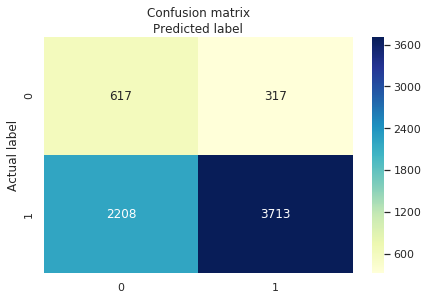

              precision    recall  f1-score   support

         0.0       0.22      0.66      0.33       934
         1.0       0.92      0.63      0.75      5921

   micro avg       0.63      0.63      0.63      6855
   macro avg       0.57      0.64      0.54      6855
weighted avg       0.83      0.63      0.69      6855

ROC-AUC 0.6438447951562091


In [0]:
# logistic regression, ignore cluster labels
model = estimate(X_train_ut, y_train_u, X_test_t, 
               y_test, model_type="logistic_regression", penalty_arg='l2', C_arg=0.1)
analyze_features(X_train_u.columns, model.coef_, model=model, model_type="logistic", limit=15)

#### Decision Tree

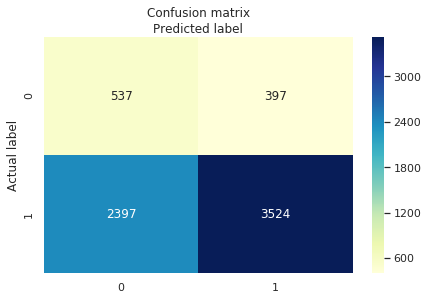

              precision    recall  f1-score   support

         0.0       0.18      0.57      0.28       934
         1.0       0.90      0.60      0.72      5921

   micro avg       0.59      0.59      0.59      6855
   macro avg       0.54      0.59      0.50      6855
weighted avg       0.80      0.59      0.66      6855

ROC-AUC 0.5850581008257547


In [0]:
# logistic regression, ignore cluster labels
model = estimate(X_train_ut, y_train_u, X_test_t, 
               y_test, model_type="decision_tree", penalty_arg='l2', C_arg=1.0)
analyze_features(X_train_u.columns, model=model, model_type="decision", limit=15)

#### XGBoost

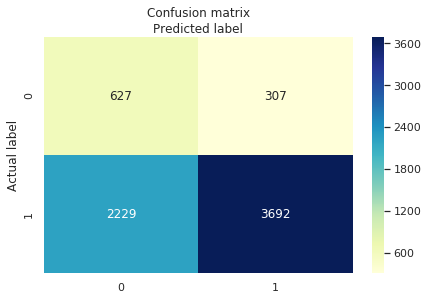

              precision    recall  f1-score   support

         0.0       0.22      0.67      0.33       934
         1.0       0.92      0.62      0.74      5921

   micro avg       0.63      0.63      0.63      6855
   macro avg       0.57      0.65      0.54      6855
weighted avg       0.83      0.63      0.69      6855

ROC-AUC 0.6474247651175886


In [0]:
# logistic regression, ignore cluster labels
model = estimate(X_train_ut, y_train_u, X_test_t, 
               y_test, model_type="XGBoost")
analyze_features(X_train_u.columns, model=model, model_type="xgboost", limit=15)

#### Light GBM

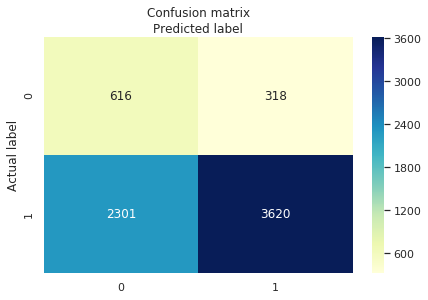

              precision    recall  f1-score   support

         0.0       0.21      0.66      0.32       934
         1.0       0.92      0.61      0.73      5921

   micro avg       0.62      0.62      0.62      6855
   macro avg       0.57      0.64      0.53      6855
weighted avg       0.82      0.62      0.68      6855

ROC-AUC 0.6354560601090664


In [0]:
# logistic regression, ignore cluster labels
model = estimate(X_train_ut, y_train_u, X_test_t, 
               y_test, model_type="lightgbm")
analyze_features(X_train_u.columns, model=model, model_type="lightgbm", limit=15)

### 6. Hyperparameter Tuning

In [0]:
# pipeline for logistic regression
pipeline_linear = make_pipeline(MinMaxScaler(), LogisticRegression(solver="liblinear"))

param_grid = {'logisticregression__C': [0.001, 0.01, 0.1, 0.15, 1, 2], 
                   'logisticregression__penalty' :['l1','l2'],
                    'logisticregression__solver' :['liblinear', 'saga'],

             }
logistic_search = GridSearchCV(pipeline_linear, param_grid, iid=False, cv=5,
                      return_train_score=True, n_jobs=-1)
logistic_search.fit(X_train_ut, y_train_u)
print(f"Best parameter {logistic_search.best_params_} \n (CV score=%0.3f): {logistic_search.best_score_}")

Best parameter {'logisticregression__C': 0.15, 'logisticregression__penalty': 'l2', 'logisticregression__solver': 'liblinear'} 
 (CV score=%0.3f): 0.6379453643450809


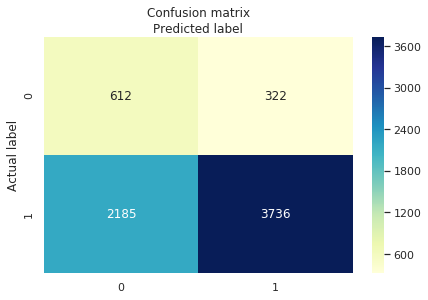

              precision    recall  f1-score   support

         0.0       0.22      0.66      0.33       934
         1.0       0.92      0.63      0.75      5921

   micro avg       0.63      0.63      0.63      6855
   macro avg       0.57      0.64      0.54      6855
weighted avg       0.83      0.63      0.69      6855

ROC-AUC 0.6431103751138745


In [0]:
# logistic regression
model = estimate(X_train_ut, y_train_u, X_test_t, 
               y_test, model_type="logistic_regression", penalty_arg='l1', C_arg=0.15, solver="liblinear")
analyze_features(X_train_u.columns, model.coef_, model=model, model_type="logistic", limit=15)

In [0]:
# tuning lightgbm


#https://lightgbm.readthedocs.io/en/latest/Parameters.html
import lightgbm as lgb
lgbm_classifier = lgb.LGBMClassifier(silent=False, n_jobs=20)

# Create parameters to search
gridParams = {}
gridParams['lgbm_classifier__metric'] = ['binary_error']
gridParams['lgbm_classifier__objective'] = ['binary']
gridParams['lgbm_classifier__max_bin'] = [300]

# the following parameters prevent overfitting
gridParams['lgbm_classifier__num_leaves'] = [150]
gridParams['lgbm_classifier__min_data_in_leaf'] = [50, 100]
#gridParams['lgbm_classifier__min_sum_hessian_in_leaf']
gridParams['lgbm_classifier__bagging_fraction'] =[0.8]
gridParams['lgbm_classifier__bagging_freq'] = [5,10]
gridParams['lgbm_classifier__feature_fraction'] = [0.7, 0.8]

gridParams['lgbm_classifier__learning_rate'] = [0.01]
gridParams['lgbm_classifier__n_estimators'] = [100]
gridParams['lgbm_classifier__max_depth'] = [30]
gridParams['lgbm_classifier__boosting_type'] = ['gbdt']
gridParams['lgbm_classifier__subsample'] = [0.7, 0.75, 0.80]
gridParams['lgbm_classifier__reg_alpha'] = [1.2]
gridParams['lgbm_classifier__reg_lambda'] = [1.2]

pipeline = Pipeline([("minmaxscaler", MinMaxScaler()),("lgbm_classifier", lgbm_classifier)])
# Create the grid
grid = GridSearchCV(pipeline, gridParams, verbose=1, cv=5, n_jobs=-1)

lgb_train_data2 =lgb.Dataset(X_train_u,label=y_train_u)

grid.fit(X_train_u, y_train_u)

# Print the best parameters found
print(grid.best_params_)
print(grid.best_score_)

Fitting 5 folds for each of 24 candidates, totalling 120 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:  3.1min
[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed:  7.3min finished


{'lgbm_classifier__bagging_fraction': 0.8, 'lgbm_classifier__bagging_freq': 5, 'lgbm_classifier__boosting_type': 'gbdt', 'lgbm_classifier__feature_fraction': 0.7, 'lgbm_classifier__learning_rate': 0.01, 'lgbm_classifier__max_bin': 300, 'lgbm_classifier__max_depth': 30, 'lgbm_classifier__metric': 'binary_error', 'lgbm_classifier__min_data_in_leaf': 50, 'lgbm_classifier__n_estimators': 100, 'lgbm_classifier__num_leaves': 150, 'lgbm_classifier__objective': 'binary', 'lgbm_classifier__reg_alpha': 1.2, 'lgbm_classifier__reg_lambda': 1.2, 'lgbm_classifier__subsample': 0.7}
0.632994380519133


### Final Thoughts




XGBoost and Logistic regression performed better. ROC AUC score is close to 0.65. 

The interest rate is determined based on how risky the loan is. The models confirmed that loans with very high interest rates are very likely to be charged off.The more credit relative to all available revolving credit, more likely to be charged off. It is not good to invest on small business. Loan grades above C are risky.                                                                                                       
Higher annual income, loan that is paid in 36 months, loan grade higher than C contribute towards full loan payment. Loans for the purpose of credit card or wedding are most likely to be fully paid.